In [116]:
import matplotlib.pyplot as plt
import seaborn as sns

# Spotify Music Recommendation Algorithm

## Metodos Auxiliares

In [119]:
def bar_plot(data, x, y, title, is_ascending=None):

    """
    Cria um gráfico de barras a partir dos dados fornecidos.

    Parâmetros:
    - data: DataFrame contendo os dados a serem plotados.
    - x: Nome da coluna para o eixo x (variável categórica).
    - y: Nome da coluna para o eixo y (variável numérica).
    - title: Título do gráfico.
    - is_ascending: Opcional; se True, ordena as barras em ordem ascendente de y; 
      se False, ordena em ordem descendente.

    Retornos:
    - Nenhum: Exibe um gráfico de barras.
    """
    
    if is_ascending is not None: 
        data = data.sort_values(by=y, ascending=is_ascending)
    
    plt.figure(figsize=(18, 6))
    plt.gca().set_facecolor('#f9f9f9')
    plt.title(title)
    plt.xlabel(x)
    plt.ylabel(y)
    
    custom_palette = sns.color_palette("Greens", n_colors=len(data))

    bar_plot = sns.barplot(data=data, x=x, y=y, hue=x, palette=custom_palette)

    for p in bar_plot.patches:
        bar_plot.annotate(f'{p.get_height():.2f}', 
                          (p.get_x() + p.get_width() / 2., p.get_height()), 
                          ha='center', va='bottom', 
                          fontsize=10, color='black', 
                          xytext=(0, 5), 
                          textcoords='offset points')

    plt.show()

In [120]:
def line_plot(data, x, y,ylabel, title):

    """
    Plota um gráfico de linhas para os dados fornecidos.

    Parameters:
    data (DataFrame): Um DataFrame do pandas que contém os dados a serem plotados.
    x (str): O nome da coluna no DataFrame que será usada no eixo x.
    y (list of str): Uma lista com os nomes das colunas no DataFrame que serão plotadas no eixo y.
    ylabel (str): O rótulo do eixo y.
    title (str): O título do gráfico.

    Returns:
    None: A função exibe o gráfico, mas não retorna nenhum valor.
    
    Example:
    line_plot(data, 'month', ['sales', 'profit'], 'Value', 'Sales and Profit Over Time')
    """

    plt.figure(figsize=(12, 6))
    for column in y:
        plt.plot(data[x], data[column], marker='o', label=column)
    
    plt.title(title)
    plt.xlabel(x)
    plt.ylabel(ylabel)
    plt.xticks(data[x]) 
    plt.legend()
    plt.grid()
    plt.show()


In [121]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

def plot_features_vs_popularity(data, decade_col, features, target='popularity'):
    """
    Cria subplots de scatterplots e linhas de regressão para as características especificadas em relação à popularidade.

    Parâmetros:
    - data: DataFrame contendo os dados a serem plotados.
    - decade_col: Nome da coluna que contém as décadas.
    - features: Lista de colunas que representam as características a serem plotadas.
    - target: Nome da coluna que contém os dados de popularidade (padrão é 'popularity').

    Retornos:
    - Nenhum: Exibe os gráficos de dispersão.
    """
    # Filtrar dados para garantir que a coluna de década não tenha valores nulos
    data = data[data[decade_col].astype(bool)]

    # Selecionar apenas colunas numéricas que não são booleanas (ou seja, que não são 0 ou 1)
    numeric_features = []
    for feature in features:
        if data[feature].dtype in ['int64', 'float64']:
            # Excluir colunas que contêm apenas 0 e 1
            if not ((data[feature].nunique() == 2) and (set(data[feature].unique()).issubset({0, 1}))):
                numeric_features.append(feature)

    # Calcular a média dos atributos por década, ignorando colunas booleanas
    mean_df = data.groupby(decade_col)[numeric_features + [target]].mean().reset_index()

    # Calcular o número de subplots
    num_features = len(numeric_features)
    num_cols = 3  # Definir um número fixo de colunas
    num_rows = np.ceil(num_features / num_cols).astype(int)  # Calcular o número de linhas

    # Tamanho da figura
    plt.figure(figsize=(5 * num_cols, 4 * num_rows))  # Ajustar o tamanho da figura dinamicamente

    # Criar subplots
    for i, feature in enumerate(numeric_features, 1):
        plt.subplot(num_rows, num_cols, i)
        
        # Scatterplot para cada feature em relação à popularidade
        sns.scatterplot(data=mean_df, x=feature, y=target, hue=decade_col, palette='viridis', alpha=0.7, s=100)
        
        # Adicionar uma linha de regressão linear sem pontos de dispersão
        sns.regplot(data=mean_df, x=feature, y=target, scatter=False, color='red')
        
        # Títulos e rótulos
        plt.title(f'Relação entre {feature} e {target.capitalize()} (Média por {decade_col.capitalize()})')
        plt.xlabel(feature)
        plt.ylabel(target.capitalize())
        plt.grid()

    # Ajustar o layout dos subplots
    plt.tight_layout()

    # Exibir os gráficos
    plt.show()



## Dicionario de Dados

In [123]:
from IPython.display import display, HTML
import pandas as pd

In [124]:
data_dictionary_path = "music_data/Spotify_Data_Dictionary.csv"
data_dictionary = pd.read_csv(data_dictionary_path, encoding='ISO-8859-1')
display(HTML(data_dictionary.to_html(escape=False, max_rows=1000)))

,variable,class,description
0,track_id,character,Song unique ID
1,track_name,character,Song Name
2,track_artist,character,Song Artist
3,track_popularity,double,Song Popularity (0-100) where higher is better
4,track_album_id,character,Album unique ID
5,track_album_name,character,Song album name
6,track_album_release_date,character,Date when album released
7,playlist_name,character,Name of playlist
8,playlist_id,character,Playlist ID
9,playlist_genre,character,Playlist genre


## Analise Exploratoria dos Dados

In [126]:
music_data_path = "music_data/music_data.csv"
genre_df_path = "music_data/data_by_genres.csv"
year_data_path = "music_data/data_by_year.csv"

music_df = pd.read_csv(music_data_path)
genre_df = pd.read_csv(genre_df_path)
year_df = pd.read_csv(year_data_path)


### Músicas

In [128]:
music_df.head()

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
0,0.0594,1921,0.982,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.665,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954
1,0.9630,1921,0.732,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.160,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936
2,0.0394,1921,0.961,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.101,-14.850,1,Gati Bali,5,1921,0.0339,110.339
3,0.1650,1921,0.967,['Frank Parker'],0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.381,-9.316,1,Danny Boy,3,1921,0.0354,100.109
4,0.2530,1921,0.957,['Phil Regan'],0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.229,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665


In [129]:
print("{} Linhas e {} Colunas".format(music_df.shape[0], music_df.shape[1]))

170653 Linhas e 19 Colunas


In [130]:
music_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

In [131]:
music_df.isnull().sum()

valence             0
year                0
acousticness        0
artists             0
danceability        0
duration_ms         0
energy              0
explicit            0
id                  0
instrumentalness    0
key                 0
liveness            0
loudness            0
mode                0
name                0
popularity          0
release_date        0
speechiness         0
tempo               0
dtype: int64

In [132]:
unic_values = []
for i in music_df.columns[0:18].tolist():
    print(i, ':', len(music_df[i].astype(str).value_counts()))
    unic_values.append(len(music_df[i].astype(str).value_counts()))

valence : 1733
year : 100
acousticness : 4689
artists : 34088
danceability : 1240
duration_ms : 51755
energy : 2332
explicit : 2
id : 170653
instrumentalness : 5401
key : 12
liveness : 1740
loudness : 25410
mode : 2
name : 133638
popularity : 100
release_date : 11244
speechiness : 1626


In [133]:
music_df.describe()

,valence,year,acousticness,danceability,duration_ms,energy,explicit,instrumentalness,key,liveness,loudness,mode,popularity,speechiness,tempo
count,170653.000000,170653.000000,170653.000000,170653.000000,1.706530e+05,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000
mean,0.528587,1976.787241,0.502115,0.537396,2.309483e+05,0.482389,0.084575,0.167010,5.199844,0.205839,-11.467990,0.706902,31.431794,0.098393,116.861590
std,0.263171,25.917853,0.376032,0.176138,1.261184e+05,0.267646,0.278249,0.313475,3.515094,0.174805,5.697943,0.455184,21.826615,0.162740,30.708533
min,0.000000,1921.000000,0.000000,0.000000,5.108000e+03,0.000000,0.000000,0.000000,0.000000,0.000000,-60.000000,0.000000,0.000000,0.000000,0.000000
25%,0.317000,1956.000000,0.102000,0.415000,1.698270e+05,0.255000,0.000000,0.000000,2.000000,0.098800,-14.615000,0.000000,11.000000,0.034900,93.421000
50%,0.540000,1977.000000,0.516000,0.548000,2.074670e+05,0.471000,0.000000,0.000216,5.000000,0.136000,-10.580000,1.000000,33.000000,0.045000,114.729000
75%,0.747000,1999.000000,0.893000,0.668000,2.624000e+05,0.703000,0.000000,0.102000,8.000000,0.261000,-7.183000,1.000000,48.000000,0.075600,135.537000
max,1.000000,2020.000000,0.996000,0.988000,5.403500e+06,1.000000,1.000000,1.000000,11.000000,1.000000,3.855000,1.000000,100.000000,0.970000,243.507000


### Gênero

In [135]:
genre_df.head()

,mode,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,21st century classical,0.979333,0.162883,1.602977e+05,0.071317,0.606834,0.361600,-31.514333,0.040567,75.336500,0.103783,27.833333,6
1,1,432hz,0.494780,0.299333,1.048887e+06,0.450678,0.477762,0.131000,-16.854000,0.076817,120.285667,0.221750,52.500000,5
2,1,8-bit,0.762000,0.712000,1.151770e+05,0.818000,0.876000,0.126000,-9.180000,0.047000,133.444000,0.975000,48.000000,7
3,1,[],0.651417,0.529093,2.328809e+05,0.419146,0.205309,0.218696,-12.288965,0.107872,112.857352,0.513604,20.859882,7
4,1,a cappella,0.676557,0.538961,1.906285e+05,0.316434,0.003003,0.172254,-12.479387,0.082851,112.110362,0.448249,45.820071,7


In [136]:
print("{} Linhas e {} Colunas".format(genre_df.shape[0], genre_df.shape[1]))

2973 Linhas e 14 Colunas


In [137]:
genre_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2973 entries, 0 to 2972
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              2973 non-null   int64  
 1   genres            2973 non-null   object 
 2   acousticness      2973 non-null   float64
 3   danceability      2973 non-null   float64
 4   duration_ms       2973 non-null   float64
 5   energy            2973 non-null   float64
 6   instrumentalness  2973 non-null   float64
 7   liveness          2973 non-null   float64
 8   loudness          2973 non-null   float64
 9   speechiness       2973 non-null   float64
 10  tempo             2973 non-null   float64
 11  valence           2973 non-null   float64
 12  popularity        2973 non-null   float64
 13  key               2973 non-null   int64  
dtypes: float64(11), int64(2), object(1)
memory usage: 325.3+ KB


In [138]:
genre_df.isnull().sum()

mode                0
genres              0
acousticness        0
danceability        0
duration_ms         0
energy              0
instrumentalness    0
liveness            0
loudness            0
speechiness         0
tempo               0
valence             0
popularity          0
key                 0
dtype: int64

In [139]:
unic_values = []
for i in genre_df.columns[0:18].tolist():
    print(i, ':', len(genre_df[i].astype(str).value_counts()))
    unic_values.append(len(genre_df[i].astype(str).value_counts()))

mode : 2
genres : 2973
acousticness : 2798
danceability : 2725
duration_ms : 2872
energy : 2778
instrumentalness : 2731
liveness : 2709
loudness : 2873
speechiness : 2707
tempo : 2872
valence : 2745
popularity : 2188
key : 12


In [140]:
genre_df.describe()

,mode,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
count,2973.000000,2973.000000,2973.000000,2.973000e+03,2973.000000,2973.000000,2973.000000,2973.000000,2973.000000,2973.000000,2973.000000,2973.000000,2973.000000
mean,0.833165,0.401241,0.537187,2.517209e+05,0.561143,0.211366,0.192800,-10.509848,0.083588,119.018723,0.492748,39.919185,5.938782
std,0.372891,0.319760,0.150668,9.465686e+04,0.234486,0.267329,0.092356,5.369202,0.080483,17.469188,0.201820,16.748723,3.368110
min,0.000000,0.000003,0.056900,3.094600e+04,0.001002,0.000000,0.022200,-41.825000,0.023800,47.135722,0.003353,0.000000,0.000000
25%,1.000000,0.119050,0.441202,2.063788e+05,0.395058,0.004835,0.137687,-12.427656,0.044900,109.198143,0.348578,32.491279,3.000000
50%,1.000000,0.321745,0.546496,2.375453e+05,0.601195,0.080700,0.178764,-9.221817,0.059457,119.194167,0.500048,43.056569,7.000000
75%,1.000000,0.673991,0.647500,2.772720e+05,0.730127,0.343333,0.220856,-6.920125,0.091000,127.508750,0.640257,51.138889,9.000000
max,1.000000,0.996000,0.929000,2.382587e+06,0.994667,0.992000,0.960000,0.060000,0.946219,204.212000,0.980000,80.666667,11.000000


### Ano

In [142]:
year_df.head()

,mode,year,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,1921,0.886896,0.418597,260537.166667,0.231815,0.344878,0.205710,-17.048667,0.073662,101.531493,0.379327,0.653333,2
1,1,1922,0.938592,0.482042,165469.746479,0.237815,0.434195,0.240720,-19.275282,0.116655,100.884521,0.535549,0.140845,10
2,1,1923,0.957247,0.577341,177942.362162,0.262406,0.371733,0.227462,-14.129211,0.093949,114.010730,0.625492,5.389189,0
3,1,1924,0.940200,0.549894,191046.707627,0.344347,0.581701,0.235219,-14.231343,0.092089,120.689572,0.663725,0.661017,10
4,1,1925,0.962607,0.573863,184986.924460,0.278594,0.418297,0.237668,-14.146414,0.111918,115.521921,0.621929,2.604317,5


In [143]:
print("{} Linhas e {} Colunas".format(year_df.shape[0], year_df.shape[1]))

100 Linhas e 14 Colunas


In [144]:
year_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              100 non-null    int64  
 1   year              100 non-null    int64  
 2   acousticness      100 non-null    float64
 3   danceability      100 non-null    float64
 4   duration_ms       100 non-null    float64
 5   energy            100 non-null    float64
 6   instrumentalness  100 non-null    float64
 7   liveness          100 non-null    float64
 8   loudness          100 non-null    float64
 9   speechiness       100 non-null    float64
 10  tempo             100 non-null    float64
 11  valence           100 non-null    float64
 12  popularity        100 non-null    float64
 13  key               100 non-null    int64  
dtypes: float64(11), int64(3)
memory usage: 11.1 KB


In [145]:
year_df.isnull().sum()

mode                0
year                0
acousticness        0
danceability        0
duration_ms         0
energy              0
instrumentalness    0
liveness            0
loudness            0
speechiness         0
tempo               0
valence             0
popularity          0
key                 0
dtype: int64

In [146]:
unic_values = []
for i in year_df.columns[0:18].tolist():
    print(i, ':', len(year_df[i].astype(str).value_counts()))
    unic_values.append(len(year_df[i].astype(str).value_counts()))

mode : 1
year : 100
acousticness : 100
danceability : 100
duration_ms : 100
energy : 100
instrumentalness : 100
liveness : 100
loudness : 100
speechiness : 100
tempo : 100
valence : 100
popularity : 100
key : 7


In [147]:
year_df.describe()

,mode,year,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
count,100.0,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.0000
mean,1.0,1970.500000,0.556317,0.536783,227296.752234,0.452705,0.193582,0.208224,-11.969054,0.105861,116.015674,0.532120,27.376065,3.7900
std,0.0,29.011492,0.275358,0.052356,25630.048065,0.161738,0.122488,0.017903,3.105610,0.082128,5.669645,0.057809,20.703197,3.5627
min,1.0,1921.000000,0.219931,0.414445,156881.657475,0.207948,0.016376,0.168450,-19.275282,0.049098,100.884521,0.379327,0.140845,0.0000
25%,1.0,1945.750000,0.289516,0.500800,210889.193536,0.280733,0.103323,0.197509,-14.189232,0.064244,111.718626,0.497174,3.298200,0.0000
50%,1.0,1970.500000,0.459190,0.540976,235520.850833,0.495997,0.127644,0.206074,-11.773061,0.085763,117.455548,0.541503,33.619250,2.0000
75%,1.0,1995.250000,0.856711,0.570948,247702.738058,0.598008,0.276707,0.218493,-9.950542,0.104438,120.606644,0.570080,44.943375,7.0000
max,1.0,2020.000000,0.962607,0.692904,267677.823086,0.681778,0.581701,0.264335,-6.595067,0.490001,124.283129,0.663725,65.256542,10.0000


### Analise Visual

In [149]:
music_df['decade'] = (music_df['year'] // 10) * 10

mean_values = music_df.groupby('decade')[['acousticness',
    'danceability',
    'duration_ms',
    'energy',
    'instrumentalness',
    'liveness',
    'loudness',
    'speechiness',
    'tempo',
    'valence']].mean().reset_index()


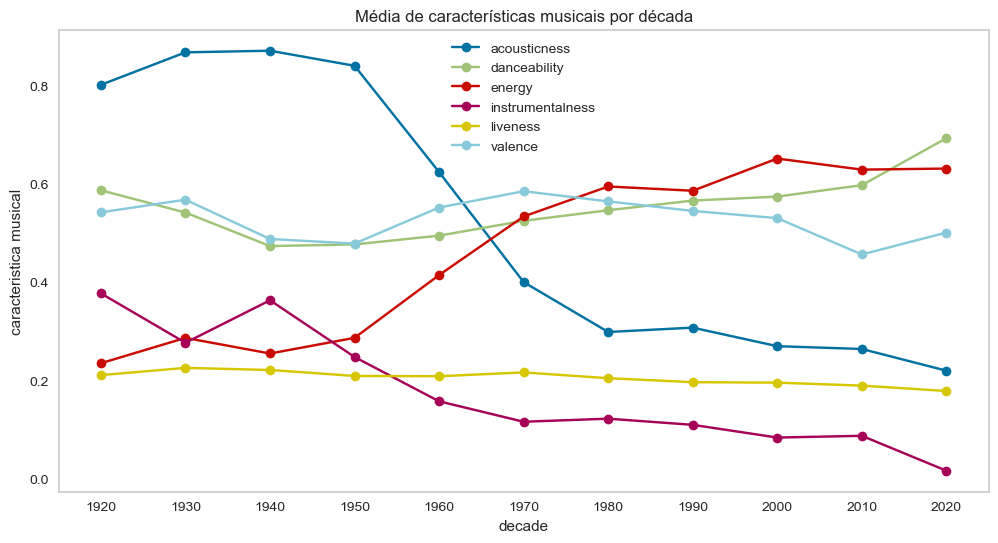

In [150]:
line_plot(data=mean_values,
          x='decade',
          y=['acousticness',
    'danceability',
    'energy',
    'instrumentalness',
    'liveness',
    'valence'],
          ylabel='caracteristica musical', 
          title='Média de características musicais por década')

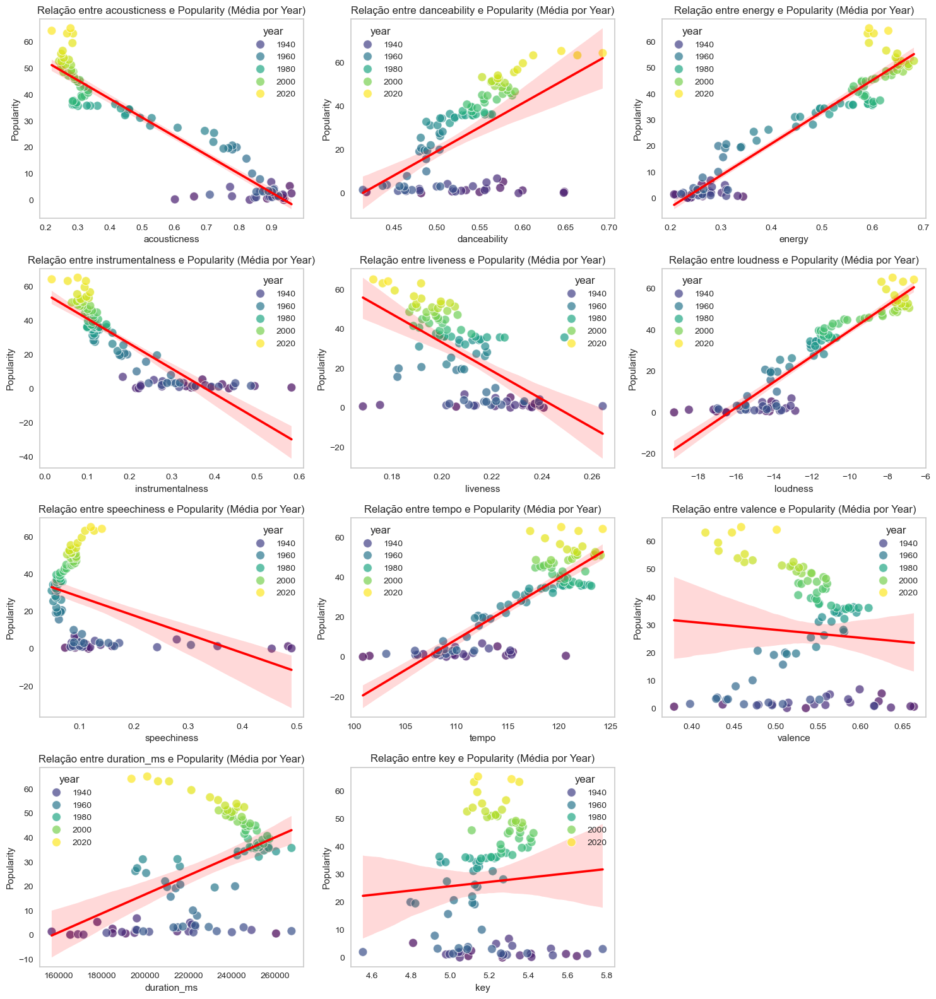

In [151]:
features = ['acousticness', 'danceability', 'energy', 'instrumentalness',
                 'liveness', 'loudness', 'speechiness', 'tempo', 
                 'valence', 'duration_ms', 'explicit', 'key', 'mode']
plot_features_vs_popularity(music_df, 'year', features, target='popularity')

## Treinamento

### Feature Correlation

#### Músicas

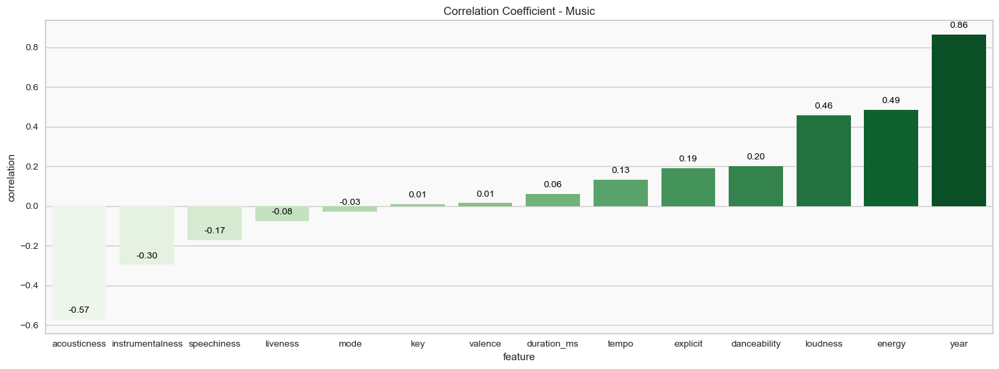

In [155]:
from yellowbrick.target import FeatureCorrelation

columns = [
    'valence',
    'year',
    'acousticness',
    'danceability',
    'duration_ms',
    'energy',
    'explicit',
    'instrumentalness',
    'key',
    'liveness',
    'loudness',
    'mode',
    'speechiness',
    'tempo'
]

X = music_df[columns]
y = music_df['popularity']

# Cria o visualizador de correlação de características
visualizer = FeatureCorrelation(labels=columns)


correlation_data = X.corrwith(y)

correlation_df = pd.DataFrame({
    'feature': correlation_data.index,
    'correlation': correlation_data.values
})

bar_plot(correlation_df, 'feature', 'correlation', title='Correlation Coefficient - Music', is_ascending=True)


#### Genero

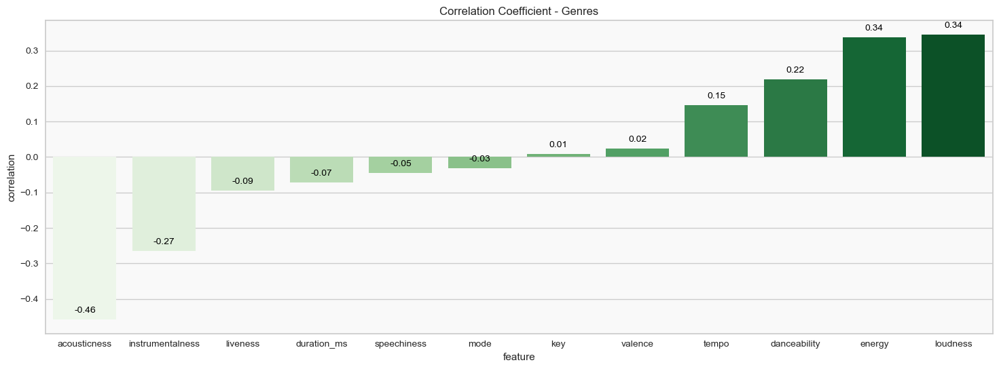

In [157]:
columns = ['mode',
    'acousticness',
    'danceability',
    'duration_ms',
    'energy',
    'instrumentalness',
    'liveness',
    'loudness',
    'speechiness',
    'tempo',
    'valence',
    'key'
]



X = genre_df[columns]
y = genre_df['popularity']

# Cria o visualizador de correlação de características
visualizer = FeatureCorrelation(labels=columns)


correlation_data = X.corrwith(y)

# Cria um DataFrame para os dados de correlação
correlation_df = pd.DataFrame({
    'feature': correlation_data.index,
    'correlation': correlation_data.values
})

# Chama a função bar_plot para visualizar a correlação
bar_plot(correlation_df, 'feature', 'correlation', title='Correlation Coefficient - Genres', is_ascending=True)




### Importancia das Variaveis

#### Musicas

In [160]:
from sklearn.ensemble import RandomForestClassifier 
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor

In [161]:
x = music_df.drop(['artists', 'id', 'name','release_date', 'popularity'], axis=1)
y = music_df['popularity']

In [162]:
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)

In [163]:
model = RandomForestClassifier()
model.fit(X_train, y_train)

RandomForestClassifier()

In [164]:
importances = model.feature_importances_
feature_names = x.columns

feature_importance_df = pd.DataFrame({'Feature': feature_names, 'Importance': importances})


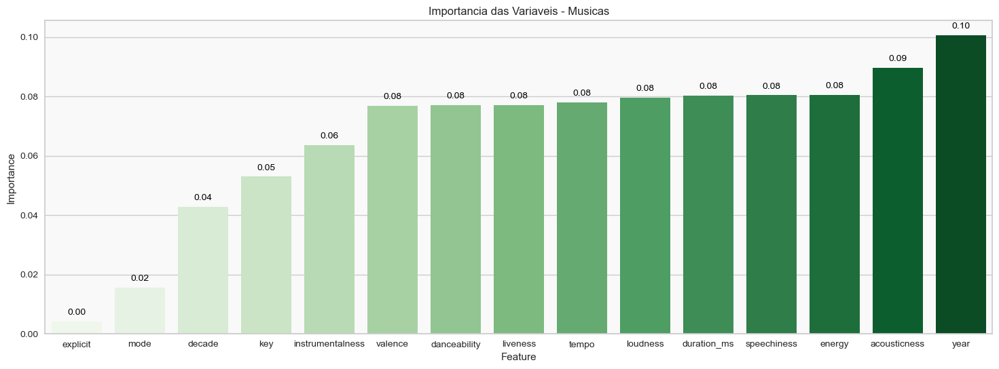

In [165]:
bar_plot(data=feature_importance_df,
         x='Feature',
         y='Importance',
         title='Importancia das Variaveis - Musicas',
         is_ascending=True)


#### Genero

In [167]:
x = genre_df.drop(['genres','popularity'], axis=1)

y = genre_df['popularity']

In [168]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [169]:
model = RandomForestRegressor() 
model.fit(X_train, y_train)

RandomForestRegressor()

In [170]:
importances = model.feature_importances_
feature_names = X.columns

feature_importance_df = pd.DataFrame({'Feature': feature_names, 'Importance': importances})


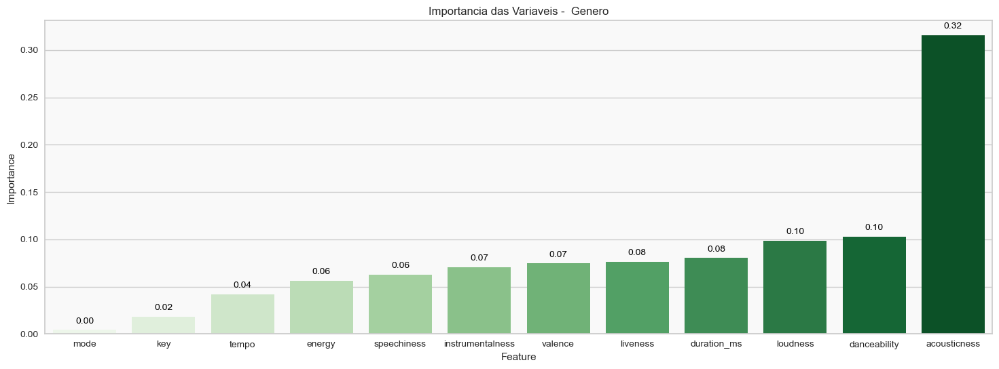

In [171]:
bar_plot(data=feature_importance_df,
         x='Feature',
         y='Importance',
         title='Importancia das Variaveis -  Genero',
         is_ascending=True)


#### Defiinição de Features

-  Usarei apenas as features com importancia maior ou igual a 0,06

In [174]:
music_features = ['valence',
    'year',
    'acousticness',
    'danceability',
    'duration_ms',
    'explicit',
    'instrumentalness',
    'liveness',
    'loudness',
    'speechiness',
    'tempo']

genres_features = ['acousticness', 
    'danceability',
    'duration_ms',
    'energy', 
    'instrumentalness',
    'liveness',
    'loudness', 
    'speechiness',
    'valence']

### Clusterização

#### Avalicação: Elbow Method

In [177]:
from sklearn.cluster import KMeans

In [178]:
x = music_df[music_features]
inertias = []
k_values = range(1, 20)


for k in k_values:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(X)
    inertias.append(kmeans.inertia_)

elbow_music = pd.DataFrame({
    'Número de Clusters (k)': k_values,
    'Inércia': inertias
})

In [179]:
X = genre_df[genres_features]

inertias = []
k_values = range(1, 20)

for k in k_values:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(X)
    inertias.append(kmeans.inertia_)

elbow_genre = pd.DataFrame({
    'Número de Clusters (k)': k_values,
    'Inércia': inertias
})


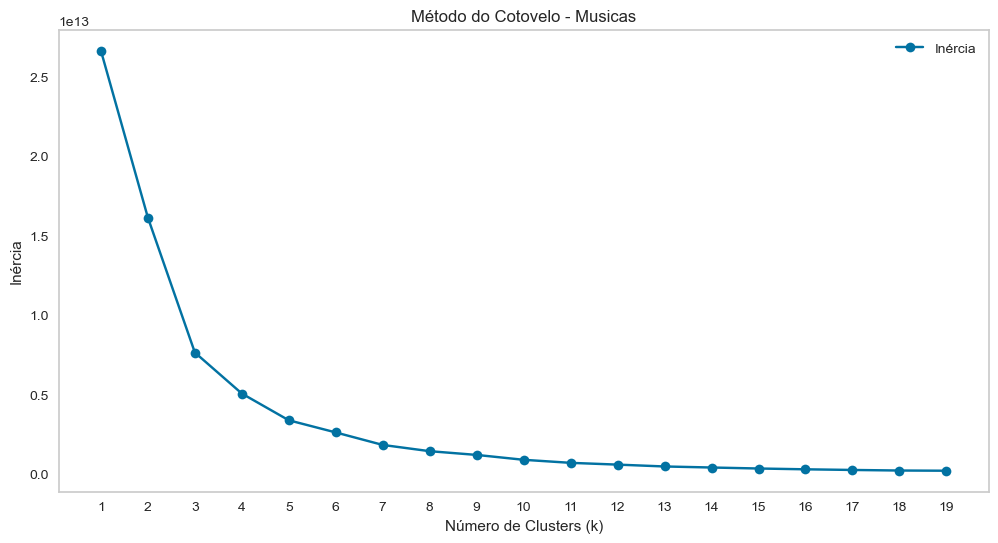

In [180]:
line_plot(elbow_music, 
          x='Número de Clusters (k)',
          y=['Inércia'], ylabel='Inércia',
          title='Método do Cotovelo - Musicas')


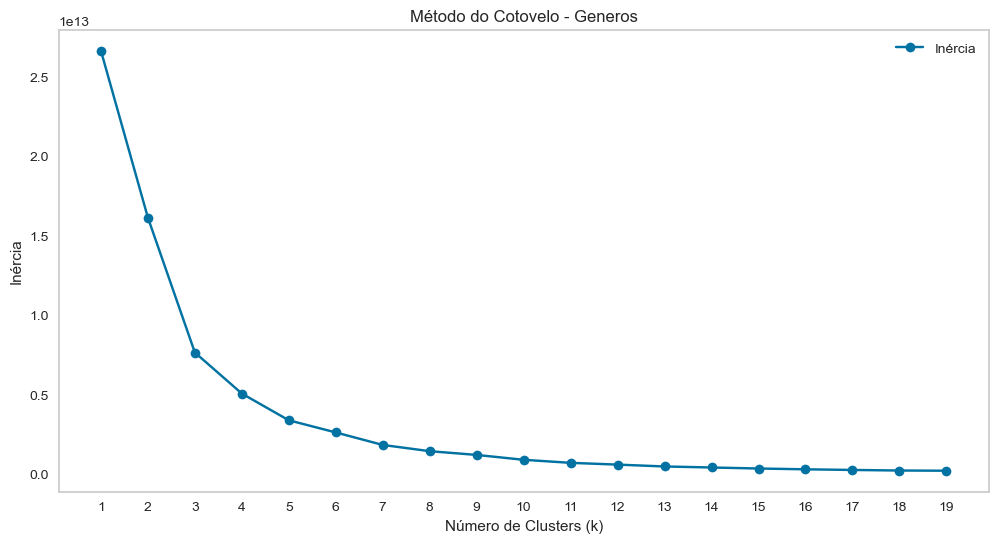

In [181]:
line_plot(elbow_genre,
          x='Número de Clusters (k)',
          y=['Inércia'],
          ylabel='Inércia',
          title='Método do Cotovelo - Generos')

- o ponto onde a inércia começa a diminuir em uma taxa mais lenta (o "cotovelo"). Esse ponto sugere o número ideal de clusters.

> Generos : 12
> 
> Musica: 12

#### Clusterização: KMeans

In [184]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
import plotly.express as px
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA


##### Musicas

In [186]:
X = music_df.select_dtypes(np.number)
number_cols = list(X.columns)

song_cluster_pipeline = Pipeline([
    ('scaler', StandardScaler()), 
    ('kmeans', KMeans(n_clusters=12, n_init=30, verbose=0))
])

song_cluster_pipeline.fit(X)

song_cluster_labels = song_cluster_pipeline.predict(X)

music_df['cluster_label'] = song_cluster_labels


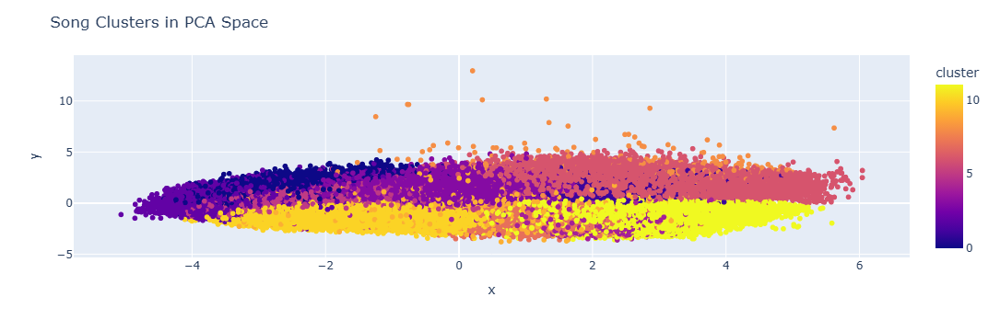

In [187]:

X = music_df.select_dtypes(np.number)


pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)


projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = music_df['name']
projection['cluster'] = music_df['cluster_label']


fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title']
)

fig.update_layout(title='Song Clusters in PCA Space')

# Show the plot
fig.show()


##### Genres

In [189]:
cluster_pipeline = Pipeline([('Scaler',
                              StandardScaler()),
                             ('KMeans',
                              KMeans(n_clusters=13,
                              n_init=30))])
X = genre_df.select_dtypes(np.number)

cluster_pipeline.fit(X)

genre_df['cluster'] = cluster_pipeline.predict(X)


In [190]:
tsne_pipeline = Pipeline([('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=1))])
genre_embedding = tsne_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection['genres'] = genre_df['genres']
projection['cluster'] = genre_df['cluster']



[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.017s...
[t-SNE] Computed neighbors for 2973 samples in 0.338s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.777516
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.106232
[t-SNE] KL divergence after 1000 iterations: 1.394532


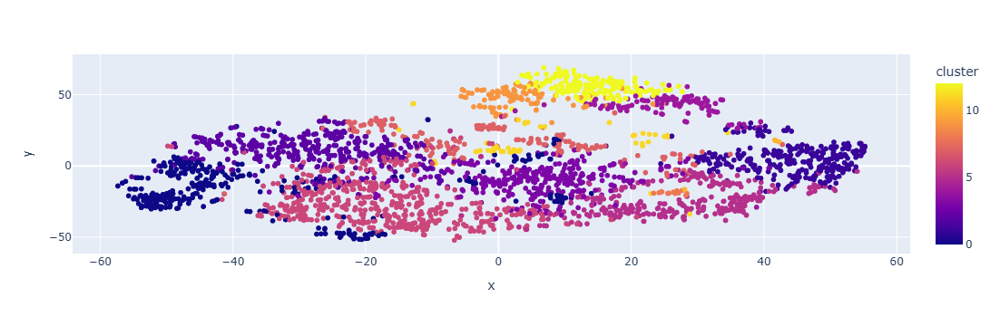

In [191]:
fig.update_layout(title='t-SNE Projection of Music Genres')
fig = px.scatter(
    projection,
    x='x',
    y='y',
    color='cluster',
    hover_data=['x', 'y', 'genres']
)

fig.show()


## Recomendacão

### Requisicão de dados do Spotify

In [194]:
import spotipy
from spotipy.oauth2 import SpotifyOAuth
import pandas as pd
import os

client_id = ''
client_secret = ''
redirect_uri = ''

sp = spotipy.Spotify(auth_manager=SpotifyOAuth(client_id=client_id,
                                               client_secret=client_secret,
                                               redirect_uri=redirect_uri,
                                               scope='user-read-recently-played'))  

try:
    
    results = sp.current_user_recently_played(limit=50)  

    
    user_recent_tracks = pd.DataFrame([{
        'id': item['track']['id'],
        'played_at': item['played_at']
    } for item in results['items']])

    
except Exception as e:
    print(f"Erro ao obter as músicas recentemente ouvidas: {e}")

In [195]:
user_recent_tracks

,id,played_at
0,2EinKMdcU9Jt4UZuG4CoA9,2024-11-04T05:34:24.600Z
1,0ESIjVxnDnCDaTPo6sStHm,2024-11-04T05:31:11.527Z
2,5iR5wHurtOVbf8fxXxNys9,2024-11-04T05:28:57.778Z
3,18qhv7DD1sEpgWffovGnhn,2024-11-04T05:24:35.305Z
4,4CeeEOM32jQcH3eN9Q2dGj,2024-11-04T05:18:03.476Z
5,0HwXmm9QsRiCbyWnwMIwnZ,2024-11-04T05:13:01.350Z
6,7GqexpRMnOdlQGUKpJvCFI,2024-11-04T05:08:05.479Z
7,52dm9op3rbfAkc1LGXgipW,2024-11-04T05:04:55.244Z
8,0la0CBKSAsu0oKkJggsCEp,2024-11-04T04:58:39.637Z
9,39VxarnBZV8POFPXvnAD2U,2024-11-04T04:54:33.521Z


### Treinamento do Algoritmo de recomendação

#### Combinando dados

In [198]:
combined_data = pd.merge(user_recent_tracks, music_df, on='id', how='inner')

print(combined_data.columns)


Index(['id', 'played_at', 'valence', 'year', 'acousticness', 'artists',
       'danceability', 'duration_ms', 'energy', 'explicit', 'instrumentalness',
       'key', 'liveness', 'loudness', 'mode', 'name', 'popularity',
       'release_date', 'speechiness', 'tempo', 'decade', 'cluster_label'],
      dtype='object')


#### Treinamento

In [200]:
features = combined_data[music_features] 
labels = combined_data['cluster_label']  

X_train, X_test, y_train, y_test = train_test_split(features, labels, test_size=0.3, random_state=42)

# Treinamento do modelo
model = RandomForestClassifier()
model.fit(X_train, y_train)

predictions = model.predict(X_test)

#### Recomendacão

In [279]:
recommended_songs = combined_data.copy()

recommended_songs['predicted_label'] = model.predict(features) 

top_recommended = recommended_songs.sort_values(by='predicted_label', ascending=False).head(3)


## Output

In [281]:
display(recommended_songs)

,id,played_at,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,...,loudness,mode,name,popularity,release_date,speechiness,tempo,decade,cluster_label,predicted_label
0,0ESIjVxnDnCDaTPo6sStHm,2024-11-04T05:31:11.527Z,0.646,1963,0.790,['The Beatles'],0.727,133507,0.33800,0,...,-13.887,1,Till There Was You - Remastered 2009,63,1963-11-22,0.0454,122.421,1960,3,7
1,18qhv7DD1sEpgWffovGnhn,2024-11-04T05:24:35.305Z,0.121,1967,0.268,['The Beatles'],0.377,330907,0.45300,0,...,-10.455,0,A Day In The Life - Remix,48,1967-05-26,0.0462,79.935,1960,9,7
2,52dm9op3rbfAkc1LGXgipW,2024-11-04T05:04:55.244Z,0.158,1971,0.687,['The Rolling Stones'],0.432,341773,0.38900,0,...,-6.517,1,Wild Horses - 2009 Mix,72,1971-04-23,0.0255,139.506,1970,3,3
3,7ouW02587AzIaGnK0gh8St,2024-11-04T03:51:20.112Z,0.133,1994,0.996,"['Johannes Brahms', 'Idil Biret']",0.387,94333,0.00906,0,...,-34.559,1,"16 Waltzes, Op. 39: No. 15 In A Flat Major",44,1994-06-07,0.0455,67.855,1990,6,6
4,1jCFnbL30NwORyVsiHX6mH,2024-11-04T02:40:09.521Z,0.897,1963,0.840,['Jorge Ben Jor'],0.747,139627,0.45400,0,...,-6.761,0,Tim Dom Dom,38,1963-01-01,0.1020,86.422,1960,7,7
5,4IIK7KvWCTSkVVRufxyh3d,2024-11-04T02:37:49.713Z,0.863,1994,0.812,['Novos Baianos'],0.544,235080,0.42500,0,...,-12.074,1,Brasil pandeiro,52,1994-05-20,0.0346,96.688,1990,10,7
6,2DREhftHdD8pRmNdSs6nyF,2024-11-04T02:31:07.519Z,0.905,1973,0.256,['Secos & Molhados'],0.574,128000,0.38900,0,...,-9.786,1,Sangue latino,56,1973,0.0295,133.661,1970,10,10
7,5MmxyCSL7xzxyRZBIVWtju,2024-11-04T02:23:20.775Z,0.596,1963,0.664,['Jorge Ben Jor'],0.486,125560,0.34700,0,...,-10.301,0,Menina Bonita Não Chora,34,1963-01-01,0.0475,79.685,1960,7,7


In [281]:
display(recommended_songs)

,id,played_at,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,...,loudness,mode,name,popularity,release_date,speechiness,tempo,decade,cluster_label,predicted_label
0,0ESIjVxnDnCDaTPo6sStHm,2024-11-04T05:31:11.527Z,0.646,1963,0.790,['The Beatles'],0.727,133507,0.33800,0,...,-13.887,1,Till There Was You - Remastered 2009,63,1963-11-22,0.0454,122.421,1960,3,7
1,18qhv7DD1sEpgWffovGnhn,2024-11-04T05:24:35.305Z,0.121,1967,0.268,['The Beatles'],0.377,330907,0.45300,0,...,-10.455,0,A Day In The Life - Remix,48,1967-05-26,0.0462,79.935,1960,9,7
2,52dm9op3rbfAkc1LGXgipW,2024-11-04T05:04:55.244Z,0.158,1971,0.687,['The Rolling Stones'],0.432,341773,0.38900,0,...,-6.517,1,Wild Horses - 2009 Mix,72,1971-04-23,0.0255,139.506,1970,3,3
3,7ouW02587AzIaGnK0gh8St,2024-11-04T03:51:20.112Z,0.133,1994,0.996,"['Johannes Brahms', 'Idil Biret']",0.387,94333,0.00906,0,...,-34.559,1,"16 Waltzes, Op. 39: No. 15 In A Flat Major",44,1994-06-07,0.0455,67.855,1990,6,6
4,1jCFnbL30NwORyVsiHX6mH,2024-11-04T02:40:09.521Z,0.897,1963,0.840,['Jorge Ben Jor'],0.747,139627,0.45400,0,...,-6.761,0,Tim Dom Dom,38,1963-01-01,0.1020,86.422,1960,7,7
5,4IIK7KvWCTSkVVRufxyh3d,2024-11-04T02:37:49.713Z,0.863,1994,0.812,['Novos Baianos'],0.544,235080,0.42500,0,...,-12.074,1,Brasil pandeiro,52,1994-05-20,0.0346,96.688,1990,10,7
6,2DREhftHdD8pRmNdSs6nyF,2024-11-04T02:31:07.519Z,0.905,1973,0.256,['Secos & Molhados'],0.574,128000,0.38900,0,...,-9.786,1,Sangue latino,56,1973,0.0295,133.661,1970,10,10
7,5MmxyCSL7xzxyRZBIVWtju,2024-11-04T02:23:20.775Z,0.596,1963,0.664,['Jorge Ben Jor'],0.486,125560,0.34700,0,...,-10.301,0,Menina Bonita Não Chora,34,1963-01-01,0.0475,79.685,1960,7,7


In [283]:
display(top_recommended)

,id,played_at,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,...,loudness,mode,name,popularity,release_date,speechiness,tempo,decade,cluster_label,predicted_label
6,2DREhftHdD8pRmNdSs6nyF,2024-11-04T02:31:07.519Z,0.905,1973,0.256,['Secos & Molhados'],0.574,128000,0.389,0,...,-9.786,1,Sangue latino,56,1973,0.0295,133.661,1970,10,10
0,0ESIjVxnDnCDaTPo6sStHm,2024-11-04T05:31:11.527Z,0.646,1963,0.790,['The Beatles'],0.727,133507,0.338,0,...,-13.887,1,Till There Was You - Remastered 2009,63,1963-11-22,0.0454,122.421,1960,3,7
1,18qhv7DD1sEpgWffovGnhn,2024-11-04T05:24:35.305Z,0.121,1967,0.268,['The Beatles'],0.377,330907,0.453,0,...,-10.455,0,A Day In The Life - Remix,48,1967-05-26,0.0462,79.935,1960,9,7


In [210]:
import pprint

recommended_songs = combined_data.copy()
recommended_songs['predicted_label'] = model.predict(features)
top_recommended = recommended_songs.sort_values(by='predicted_label', ascending=False).head(3)
recommended_dict = {
    'recommended_songs': top_recommended[['name', 'artists', 'predicted_label']].to_dict(orient='records')
}

pprint.pprint(recommended_dict)


{'recommended_songs': [{'artists': "['Secos & Molhados']",
                        'name': 'Sangue latino',
                        'predicted_label': 10},
                       {'artists': "['The Beatles']",
                        'name': 'Till There Was You - Remastered 2009',
                        'predicted_label': 7},
                       {'artists': "['The Beatles']",
                        'name': 'A Day In The Life - Remix',
                        'predicted_label': 7}]}
